#      Institut Francophone International

   **MODULE VISION PAR ORDINATEUR - M2 - Promo 24 - Mars 2021**
   
TP3 – Segmentation des objets en se basant sur le flux optique

#### Groupe_4 : Jean-Bertrand Fritzner & Michelet Juste

**Importation des bibliotheques**

In [2]:
!pip install opencv-python

## Estimation du flot optique dans une séquence d'images

-	Nous allons tout d’abord utiliser la fonction cv.calcOpticalFlowPyrLK () pour suivre les points caractéristiques de la vidéo

### Flux optique Lucas-Kanade

Dans le domaine de la vision par ordinateur, la méthode Lucas–Kanade est une méthode différentielle utilisée pour l'estimation du flux optique. Cette méthode a été développée par Bruce D. Lucas et Takeo Kanade. Elle suppose que le flot est essentiellement constant dans un voisinage local du pixel considéré, et résout l'équation du flot optique pour tous les pixels dans ce voisinage par la méthode des moindres carrés1,2.

En combinant les informations des pixels proches environnant, la méthode de Lucas-Kanade peut souvent résoudre l'ambiguïté inhérente de l'équation du flot optique : le problème de l'ouverture. Cependant, comme c'est une méthode purement locale, elle ne peut pas fournir d'information sur le flux à l'intérieur d'une région uniforme de l'image.

In [3]:
import cv2 as cv
import numpy as np
from IPython.display import Video
import matplotlib.pyplot as plt

#Shi-Tomasi corner detection
feature_params = dict(maxCorners = 300, qualityLevel = 0.2, minDistance = 2, blockSize = 7)

#Lucas-Kanade optical flow process parameters 
lk_params = dict(winSize = (15,15), maxLevel = 2, criteria = (cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 0.03))

# Input video
cap = cv.VideoCapture("ADL-Rundle-6-raw.webm")

#color to draw flow track
color = (0, 255, 0)

#reading the frames of video
ret, first_frame = cap.read()

# Converts frame to grayscale because we only need the luminance channel for detecting edges 
prev_gray = cv.cvtColor(first_frame, cv.COLOR_BGR2GRAY)

#points good points/pixel
prev = cv.goodFeaturesToTrack(prev_gray, mask = None, **feature_params)
mask = np.zeros_like(first_frame)

while(cap.isOpened()):
    
    ret, frame = cap.read()
    gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
    
    #flow process
    next, status, error = cv.calcOpticalFlowPyrLK(prev_gray, gray, prev, None, **lk_params)
    good_old = prev[status == 1]#position variables
    good_new = next[status == 1]#position variables
    #marking flow tracks
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.ravel()
        c, d = old.ravel()
        mask = cv.line(mask, (a, b), (c, d), color, 1)
        frame = cv.circle(frame, (a, b), 2, color, -1)
    output = cv.add(frame, mask)
    prev_gray = gray.copy()
    prev = good_new.reshape(-1, 1, 2)
    
    #output function
    cv.imshow("sparse optical flow", output)
    
    #function to destroy window
    if cv.waitKey(10) & 0xFF == ord('q'):
        break

#clears memory
cap.release()
cv.destroyAllWindows()


error: OpenCV(4.5.1) C:\Users\appveyor\AppData\Local\Temp\1\pip-req-build-oduouqig\opencv\modules\imgproc\src\color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cv::cvtColor'


### Flux Optique Dense

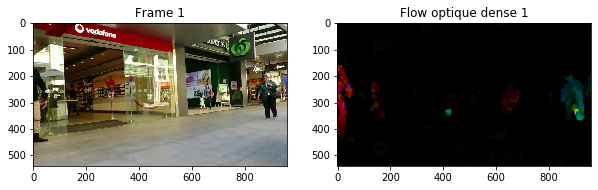

In [6]:
import cv2 as cv
import numpy as np
from IPython.display import Video
import matplotlib.pyplot as plt

#chargement de la video 
cap = cv.VideoCapture("ADL-Rundle-6-raw.webm")

#Lecture de chaque frame de la video
ret, first_frame = cap.read()
#frame precedant recuérer en niveau de gris
prev_gray = cv.cvtColor(first_frame, cv.COLOR_BGR2GRAY)
mask = np.zeros_like(first_frame)

# Sets image saturation to maximum
mask[..., 1] = 255

#pour chaque frame, appliqué le calcul de flow
idx_frame = 1
while(1):
    ret, frame = cap.read()
    if ret==False: #s'il n'y a plus de frame, si la vidéo est a la fin, sortir de la boucle
        break
    gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
    
    #on calcul le flow à partir du frame précedant #dense optical flow 
    flow = cv.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 10, 3, 5, 1.2, 0)
    
    #Recupération du vecteur de flow optique dense (l'angele et la magnetitude) avec la fonction cartToPolar()  d'OpenCV
    magnitude, angle = cv.cartToPolar(flow[..., 0], flow[..., 1])
    
    mask[...,0] = angle * 180 / np.pi / 2
    # Sets image value according to the optical flow magnitude 
    mask[..., 2] = cv.normalize(magnitude, None, 0, 255, cv.NORM_MINMAX)
    
    
    # Pour avoir les valeurs normalisées en nombre e ntier entre 0 et 255, nous convertissons les pixels de HSV à BGR
    bgr = cv.cvtColor(mask, cv.COLOR_HSV2BGR)
    
    numpy_horizontal = np.hstack((frame, bgr))
    cv.resizeWindow('image', 100, 80) 
    cv.imshow('Image et ',numpy_horizontal)
    
    #convertir BGR en RGB
    frame = cv.cvtColor(frame, cv.COLOR_BGR2RGB)
    rgb = cv.cvtColor(bgr, cv.COLOR_BGR2RGB)   
    k = cv.waitKey(30) & 0xff

    if k == 27:
        break
    elif k == ord('s'): #nous pouvons sauvegarder le frame courant dans le reppertoir "images" en apuyant sur la lettre "s"
        cv.imwrite('images/'+ str(idx_frame)+'frame_courant.png', frame)
        cv.imwrite('images/'+ str(idx_frame)+'flux_optique_correspondant.png', rgb)
    prev_gray = gray
    
    #Visualisation des frames courrant et de son flow optique
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(frame)
    plt.title("Frame " + str(idx_frame))
    plt.subplot(1,2,2)
    plt.imshow(rgb)
    plt.title("Flow optique dense "+ str(idx_frame))
    plt.show()
    idx_frame=idx_frame + 1
    
    #libération de la mémoire
    cap.release()
    cv.destroyAllWindows()

# Segmentation des objets en mouvement - avec un seuil

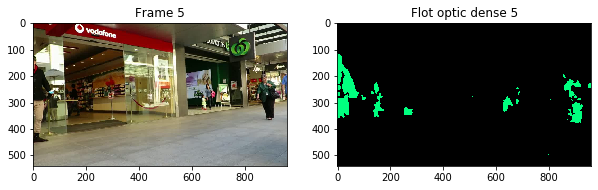

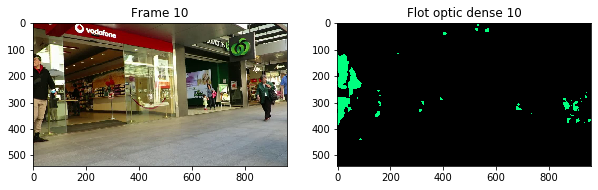

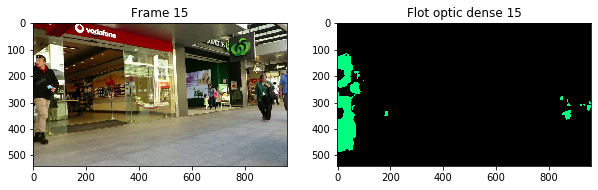

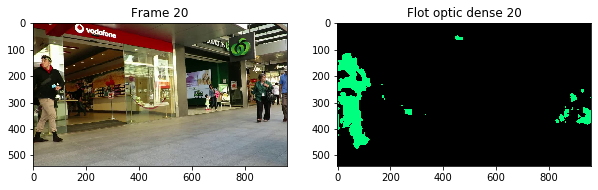

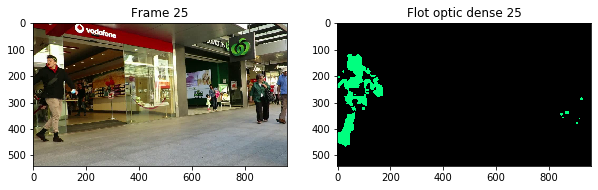

...

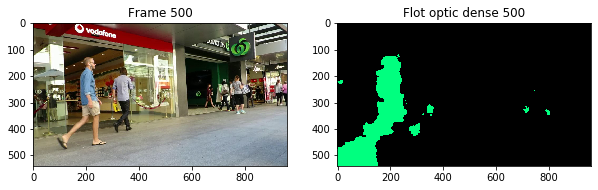

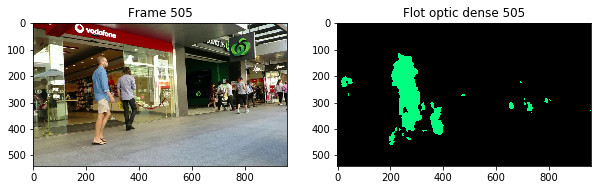

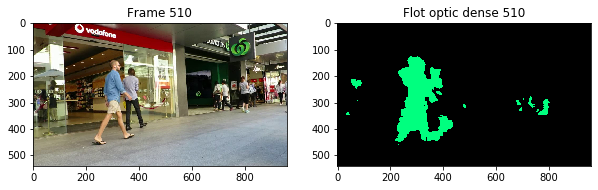

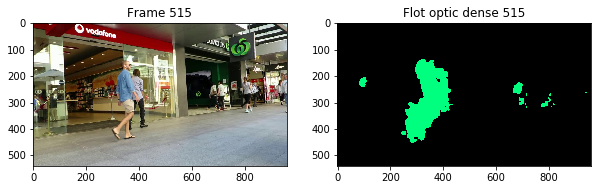

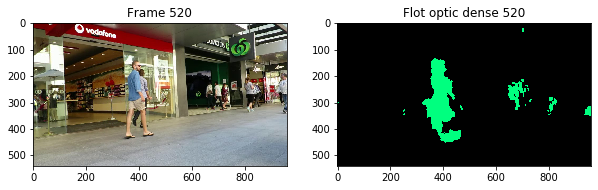

In [33]:
import cv2 as cv 
import numpy as np 
from IPython.display import Video
import matplotlib.pyplot as plt
  
#chargement de la vidéo source 
cap = cv.VideoCapture("ADL-Rundle-6-raw.webm") 

ret, frame1 = cap.read()

#frame precedant recuérer en niveau de gris
prvs = cv.cvtColor(frame1,cv.COLOR_BGR2GRAY)

hsv = np.zeros_like(frame1)
#pour chaque frame, appliqué le calcul de flow
idx_frame=1
hsv[...,0] = 255 # angle
hsv[...,1] = 255 # magnétude
s1=50

while(1):
    ret, frame2 = cap.read()
    if ret==False: #s'il n'y aplus de frame, si la vidéo est a la fin, sortir de la boucle
        break
    next = cv.cvtColor(frame2,cv.COLOR_BGR2GRAY)
    
   
    #on calcul le flow à partir du frame précedant 
    flow = cv.calcOpticalFlowFarneback(prvs,next, None, 0.5, 3, 10, 3,5, 0.5,0)
    
    #Recupération du vecteur de flow optique dense (l'angle et la magnetitude) avec la fonction cartToPolar()  d'OpenCV
    mag, ang = cv.cartToPolar(flow[...,0], flow[...,1])
    
   # hsv[...,0] = ang*180/np.pi/2
    mag = cv.normalize(mag,None,0,255,cv.NORM_MINMAX) # la luminosité
 
    for i in range(mag.shape[0]): #seuil = 125
        for j in range(mag.shape[1]):
            if mag[i][j]<=s1:
                hsv[...,2][i][j]=0
            else:
                hsv[...,2][i][j]=255 
    
    # Pour avoir les valeurs normalisées en nombre e ntier entre 0 et 255, nous convertissons les pixels de HSV à BGR
    bgr = cv.cvtColor(hsv,cv.COLOR_HSV2BGR)
    # récupréation
    
    numpy_horizontal = np.hstack((frame2, bgr))
    cv.resizeWindow('image', 120,100) 
    cv.imshow('Image et ', numpy_horizontal)
    
    k = cv.waitKey(30) & 0xff

    if k == 27:
        break
    elif k == ord('s'): #nous pouvons sauvegarder le frame courant dans le reppertoir "images" en apuyant sur la lettre "s"
        cv.imwrite('images/'+ str(idx_frame)+'frame_courant.png',frame2)
        cv.imwrite('images/'+ str(idx_frame)+'flow_optic_correspondant.png',bgr)
    prvs = next
    
    if idx_frame%5==0:
        #Visualisation des frames courrant et de son flow optique
        plt.figure(figsize=(10,10))
        plt.subplot(1,2,1)
        plt.imshow(cv.cvtColor(frame2,cv.COLOR_BGR2RGB))
        plt.title("Frame " + str(idx_frame))
        plt.subplot(1,2,2)
        plt.imshow(cv.cvtColor(bgr,cv.COLOR_BGR2RGB))
        plt.title("Flux optique Dense - Segmentation objet "+ str(idx_frame))
        plt.show()
    idx_frame=idx_frame+1
#libération de la mémoire
cap.release()
cv.destroyAllWindows()

# Segmentation des objets en mouvement - avec trois seuils

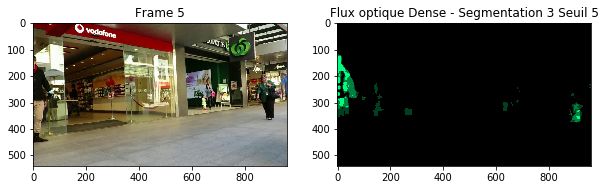

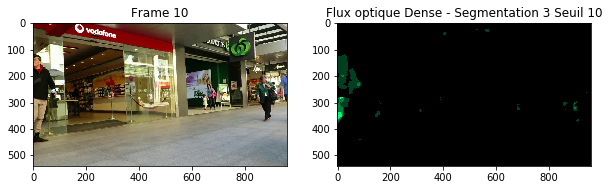

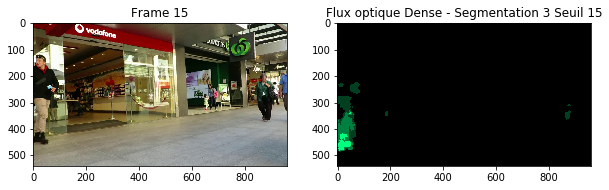

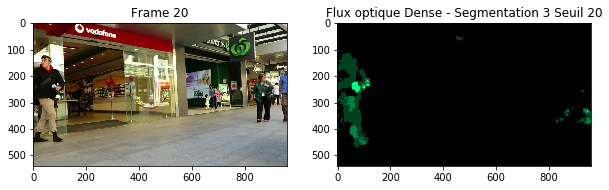

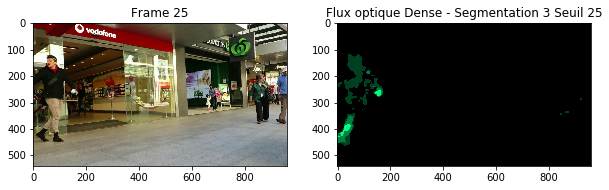

...

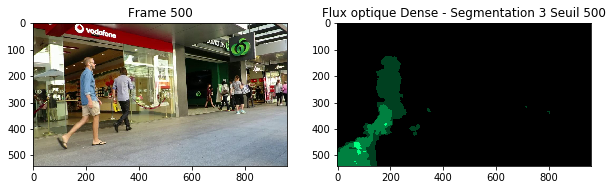

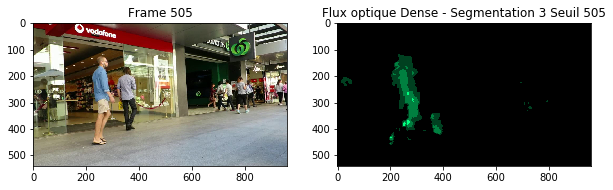

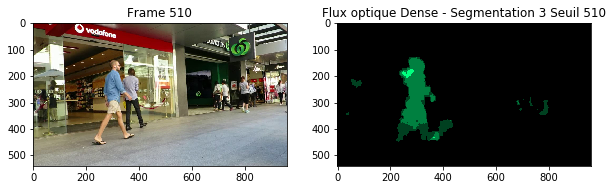

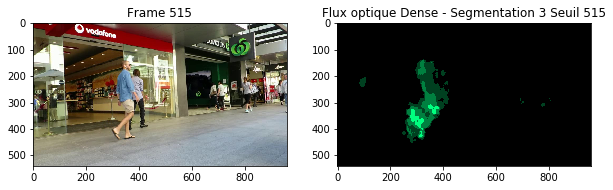

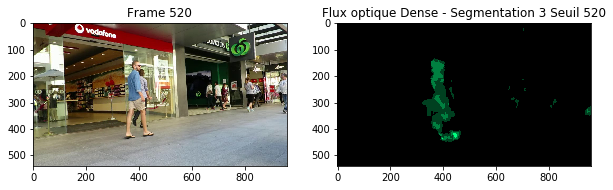

In [35]:
#chargement de la vidéo source
cap = cv.VideoCapture("ADL-Rundle-6-raw.webm") 

ret, frame1 = cap.read()

#frame precedant recuérer en niveau de gris
prvs = cv.cvtColor(frame1,cv.COLOR_BGR2GRAY)

hsv = np.zeros_like(frame1)
#pour chaque frame, appliqué le calcul de flow
idx_frame=1
hsv[...,0] = 255 # angle
hsv[...,1] = 255 # magnétude
s1=64
s2=128
s3=192
while(1):
    ret, frame2 = cap.read()
    if ret==False: #s'il n'y aplus de frame, si la vidéo est a la fin, sortir de la boucle
        break
    next = cv.cvtColor(frame2,cv.COLOR_BGR2GRAY)
    
   
    #on calcul le flow à partir du frame précedant 
    flow = cv.calcOpticalFlowFarneback(prvs,next, None, 0.5, 3, 10, 3,5, 0.5,0)
    
    #Recupération du vecteur de flow optique dense (l'angle et la magnetitude) avec la fonction cartToPolar()  d'OpenCV
    mag, ang = cv.cartToPolar(flow[...,0], flow[...,1])
    
   # hsv[...,0] = ang*180/np.pi/2
    mag = cv.normalize(mag,None,0,255,cv.NORM_MINMAX) # la luminosité

    for i in range(mag.shape[0]): #seuil = 125
        for j in range(mag.shape[1]):
            if mag[i][j]<s1:
                hsv[...,2][i][j]=0
            elif mag[i][j]<s2:
                hsv[...,2][i][j]=s1
            elif mag[i][j]<s3:
                hsv[...,2][i][j]=s2 
            else:
                hsv[...,2][i][j]=255 
    
    # Pour avoir les valeurs normalisées en nombre e ntier entre 0 et 255, nous convertissons les pixels de HSV à BGR
    bgr = cv.cvtColor(hsv,cv.COLOR_HSV2BGR)
    # récupréation
    
    numpy_horizontal = np.hstack((frame2, bgr))
    cv.resizeWindow('image', 120,100) 
    cv.imshow('Image et ', numpy_horizontal)
    
    k = cv.waitKey(30) & 0xff

    if k == 27:
        break
    elif k == ord('s'): #nous pouvons sauvegarder le frame courant dans le reppertoir "images" en apuyant sur la lettre "s"
        cv.imwrite('images/'+ str(i)+'frame_courant.png',frame2)
        cv.imwrite('images/'+ str(i)+'flow_optic_correspondant.png',bgr)
    prvs = next
    if idx_frame%5==0:
        #Visualisation des frames courrant et de son flow optique
        plt.figure(figsize=(10,10))
        plt.subplot(1,2,1)
        plt.imshow(cv.cvtColor(frame2,cv.COLOR_BGR2RGB))
        plt.title("Frame " + str(idx_frame))
        plt.subplot(1,2,2)
        plt.imshow(cv.cvtColor(bgr,cv.COLOR_BGR2RGB))
        plt.title("Flux optique Dense - Segmentation 3 Seuil "+ str(idx_frame))
        plt.show()
    idx_frame=idx_frame+1
#libération de la mémoire
cap.release()
cv.destroyAllWindows()